<a href="https://colab.research.google.com/github/astasofie/Digital_Methods/blob/main/CRS_summerschool_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Welcome to this notebook where we will be doing a hSBM topic model of the "Refugee Appeal Division Bulk Decisions Dataset" from the CRS Refugee Law Lab.

**A few technical/practical comments**
* we will be working in Google Colab which means that to import files stored on your laptop, you first need to import it into Google. Simply just click the folder icon in the left side of the screen and drag and drop the data you want to work with. Similarly, if you want to download files locally, you need to right click and download.
* Do not work with data that is not publicly avaliable in Google Colab. I recommend VS Code or jupyter notebook via Anaconda Navigator
* You can use Gemini to genrate code or get help debugging your code, but its pretty flawed
* a dash (#) will make a line a comment. Try commenting out code you don't want to run instead of deleting it, until it works.



To see more data avaliable: https://refugeelab.ca/bulk-data/

Visit GitHub to see more about the data and how to parse it: https://github.com/Refugee-Law-Lab/rad_bulk_data/tree/main

To read more about how I've used hSBM topic modelling check out this blogpost https://asylumdata.ku.dk/data-blog/2023/using-topic-modelling/

#Installing packages
Run everytime the session (re)starts![hSBM_Topicmodel2.png](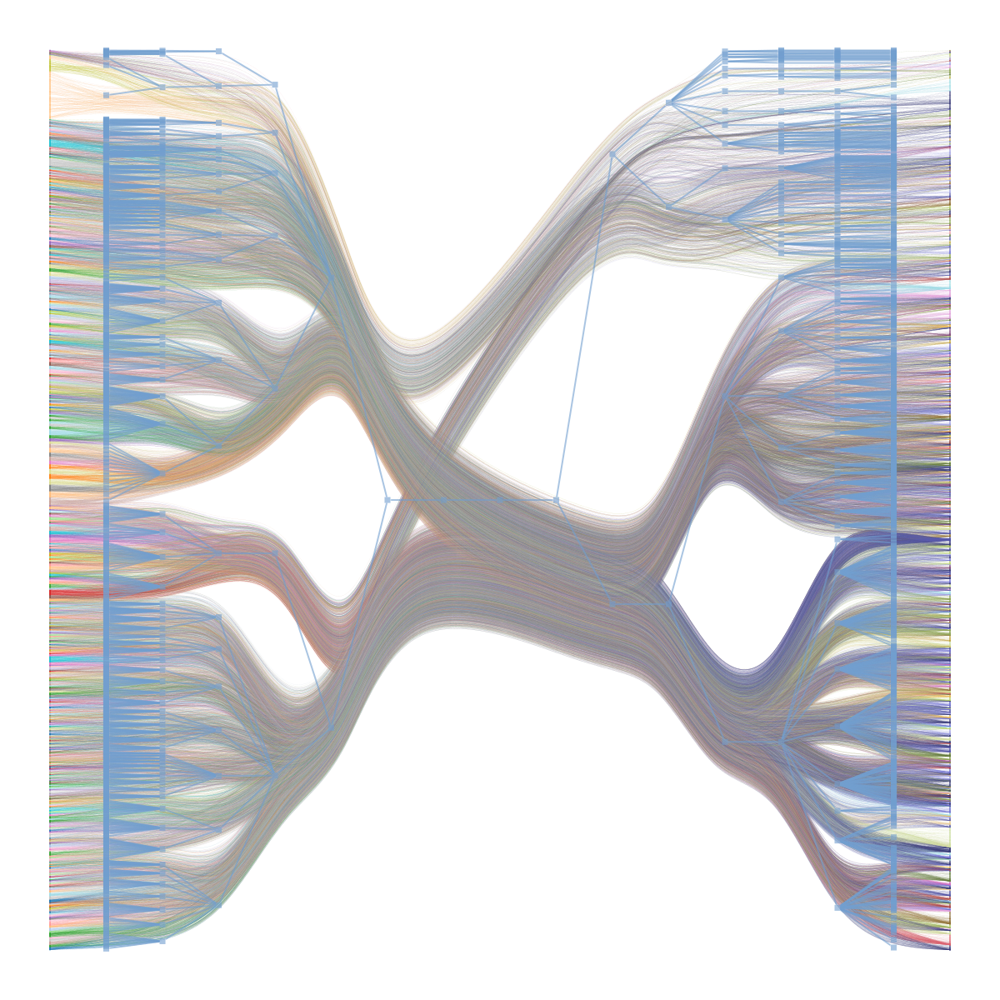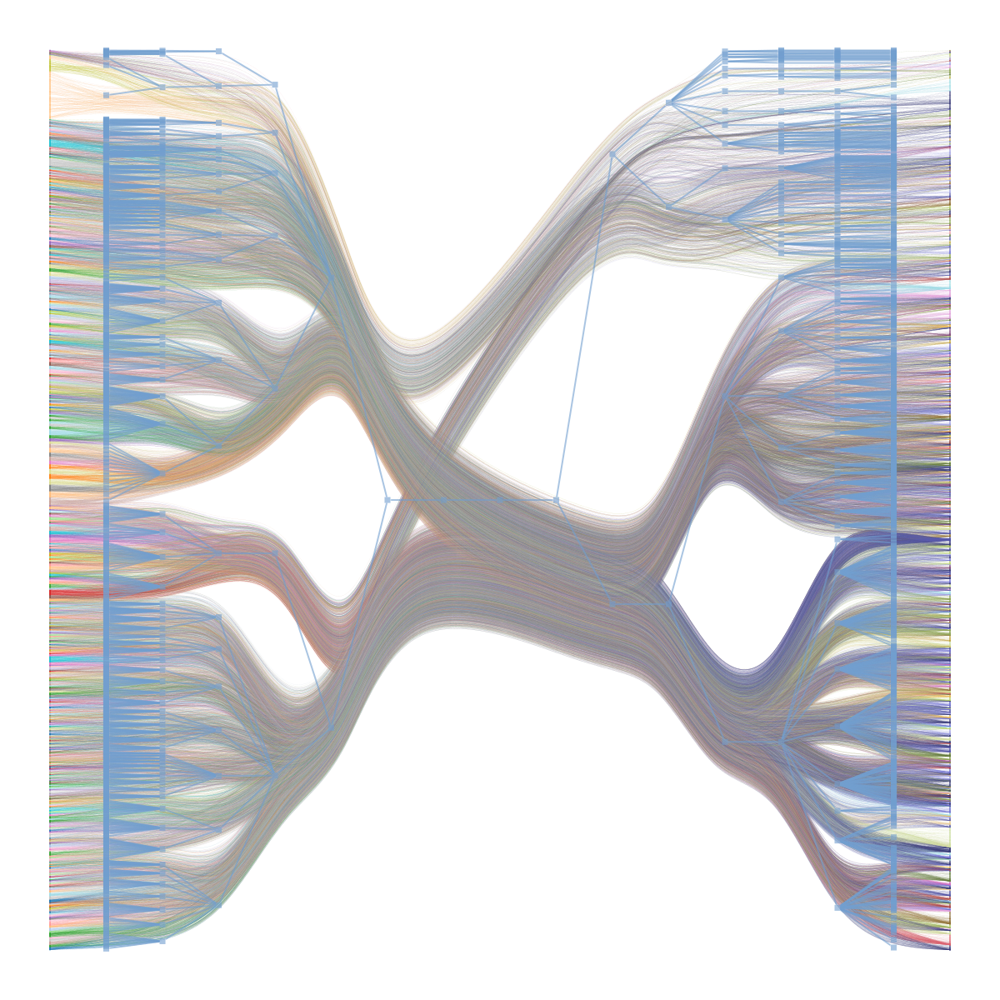)

In [1]:
#install the datasets package to be able to load the CRS data
!pip install datasets

In [2]:
#Install tqdm to see a progress bar
!pip install tqdm

In [3]:
# install dependencies for hSBM
!pip install -q condacolab
import condacolab
condacolab.install()
import condacolab
#condacolab.check()

# Install
#condacolab.check()
! conda config --add channels conda-forge
! conda config --add channels ostrokach-forge
! conda config --add channels pkgw-forge
! conda install gtk3
! conda install pygobject graph-tool cairo
! conda install -c conda-forge graph-tool
! git clone https://github.com/martingerlach/hSBM_Topicmodel.git

✨🍰✨ Everything looks OK!
Channels:
 - pkgw-forge
 - ostrokach-forge
 - conda-forge
Platform: linux-64
Solving environment: - \ | / - \ | / - \ | done


==> WARNING: A newer version of conda exists. <==
    current version: 23.11.0
    latest version: 24.5.0

Please update conda by running

    $ conda update -n base -c conda-forge conda



# All requested packages already installed.

Channels:
 - pkgw-forge
 - ostrokach-forge
 - conda-forge
Platform: linux-64
Solving environment: / - \ | / - \ done


==> WARNING: A newer version of conda exists. <==
    current version: 23.11.0
    latest version: 24.5.0

Please update conda by running

    $ conda update -n base -c conda-forge conda



# All requested packages already installed.

Channels:
 - conda-forge
 - pkgw-forge
 - ostrokach-forge
Platform: linux-64
Solving environment: / - \ | / - \ | / - \ | done


==> WARNING: A newer version of conda exists. <==
    current version:

In [50]:
#Loading packages
from tqdm import tqdm #progress bar
from tqdm.notebook import tqdm

import re #regular epxressions
from datasets import load_dataset #dataset
import pandas as pd #pandas for dataframe
import random


import json #for dictionaries
import numpy as np #package for numerig data
import pickle

#Importing modules for preprocessing
import nltk
nltk.download('punkt')
from nltk import word_tokenize
import string
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('wordnet')

import matplotlib.pyplot as plt #for graphs
import seaborn as sns
from google.colab import files


# # Importing modules for HSBM
import graph_tool.all as gt
from hSBM_Topicmodel.sbmtm import sbmtm
import collections
from collections import Counter


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


#Loading the data

In [5]:
#Loading CRS data from HuggingFace. Its made for supervised machine learning and split in training and test data.
#for the exercise here are are just going to ignore that and work on the training data
dataset = load_dataset("refugee-law-lab/canadian-legal-data", "RAD", split="train")

# convert to pandas dataframe
df = pd.DataFrame(dataset)

df.head()

/usr/local/lib/python3.10/site-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


,citation,citation2,dataset,name,source_url,scraped_timestamp,document_date,year,unofficial_text,language,other
0,TC1-04323,,RAD,,ASC Voting - TC1-04323 - EN.txt,2024-04-11,2022-01-26,2022,\nRAD File / Dossier de la SAR : TC1-04323\nPr...,en,
1,TC1-04323,,RAD,,ASC Voting - TC1-04323 - FR.txt,2024-04-11,2022-01-26,2022,\nDossier de la SAR / RAD File: TC1-04323\nHui...,fr,
2,MB7-00112,,RAD,,MB7-00112a.txt,2023-11-12,2020-09-15,2020,\nRAD File / Dossier de la SAR : MB7-00112\nPr...,en,
3,MB7-00112,,RAD,,MB7-00112tf.txt,2023-11-12,2020-09-15,2020,\nDossier de la SAR / RAD File: MB7-00112\nHui...,fr,
4,MB7-03926,,RAD,,MB7-03926f.txt,2023-11-12,2020-10-26,2020,\nDossier de la SAR / RAD File : MB7-03926\nMB...,fr,


In [ ]:
df.columns

Index(['citation', 'citation2', 'dataset', 'name', 'source_url',
       'scraped_timestamp', 'document_date', 'year', 'unofficial_text',
       'language', 'other'],
      dtype='object')

In [6]:
#Subsetting to only keep relevant info. Because we're working with language we drop the french files
df = df[df["language"] == 'en']
df = df[["citation", "citation2", "year", "unofficial_text"]]

df=df.reset_index(drop=True)

In [7]:
# Clean text of cases
def clean_text(text):

    # remove \xa0
    text = text.replace('\xa0', ' ')

    # Remove multiple whitespaces and preserve paragraphs
    text = '\n'.join([re.sub(r'\s+', ' ', line.strip()) for line in text.split('\n')])

    # # Remove single newlines
    # text = re.sub(r'(?<!\n)\n(?!\n)', ' ', text)

    # Convert multiple newlines to single newlines
    text = re.sub(r'\n+', '\n', text)

    # Remove all strings '\n[Page #]\n' (with # being a number of up to 4 digits
    text = re.sub(r'\n\[Page \d{1,3}\]\n', ' ', text)
    text = re.sub(r'\n', '', text)
    text = re.sub(r'xxxx', '', text)

    return text

tqdm.pandas()
df['unofficial_text'] = df.unofficial_text.progress_apply(clean_text)

  0%|          | 0/13847 [00:00<?, ?it/s]

#We familiarize ourselves with the data

In [ ]:
# Yearly counts
year_counts = df.year.value_counts()
years_count = sorted(year_counts.index)
for year_count in years_count:
    print(f'{year_count}: {year_counts[year_count]}')


2013: 423
2014: 1350
2015: 1766
2016: 1414
2017: 629
2018: 1007
2019: 2321
2020: 3143
2021: 1699
2022: 89
2023: 6


In [9]:
# select 20 random rows from df_unique, iterate through them and print unofficial text
# select 3 random rows from df
random.seed(42)

random_rows = random.sample(range(0, len(df)), 3)

# iterate through random rows and print unofficial text
for row in random_rows:
    print('##################################')
    print(df.iloc[row]['citation'])
    print(df.iloc[row]['year'])
    print('##################################')
    print()
    print(df.iloc[row]['unofficial_text'])
    print()
    print()
    print('____________________________________________________________________________')
    print()
    print()
    print()

##################################
MB9-09298
2020
##################################

RAD File / Dossier de la SAR : MB9-09298MB9-09299 / MB9-09300 / MB9-09301MB9-09302Private Proceeding / Huis closReasons and decision ? Motifs et décisionPersons who are the subject of the appealXXXX XXXX XXXX XXXXXXXX XXXX XXXX XXXXXXXX XXXX XXXX XXXXXXXX XXXX XXXX XXXXXXXX XXXX XXXXPersonnes en causeAppeal considered / heard atOttawa, ONAppel instruit / entendu àDate of decisionJanuary 23 2020Date de la décisionPanelPamela ArnottTribunalCounsel for the persons who are the subject of the appealJohnson BabalolaConseil des personnes en causeDesignated representativeXXXX XXXX XXXXReprésentant(e) désigné(e)Counsel for the MinisterN/AConseil du ministreREASONS FOR DECISIONOVERVIEW[1] XXXX XXXX XXXX (Principal Appellant) and XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX (Associate Appellants), citizens of Nigeria, appeal a decision of the Refugee Protection Division (RPD) reject

In [ ]:
df.unofficial_text[1]

"RAD File / Dossier de la SAR : MB7-00112Private Proceeding / Huis closReasons and decision ? Motifs et décisionPerson who is the subject of the appealXXXX XXXX XXXX XXXXPersonne en causeAppeal considered / heard atMontreal, QCAppel instruit / entendu àDate of decisionSeptember 15, 2020Date de la décisionPanelMe Richard SheitoyanTribunalCounsel for the person who is the subject of the appealLobat SadrehashemiConseil de la personne en causeDesignated representativeN/AReprésentant(e) désigné(e)Counsel for the MinisterKamal GillConseil du ministreREASONS FOR DECISIONOVERVIEW[1] I dismiss this appeal. XXXX XXXX XXXX XXXX is a citizen of Colombia and of Costa Rica.[2] Mrs. XXXX:- fled Colombia in XXXX 2007 after witnessing a murder and being threatened by the Revolutionary Armed Force of Colombia (FARC);- relocated in November to an area a further 6 hours away than the original April 2007 Costa Rican destination after witnessing the murder of a friend's relative and being warned not to disc

In [ ]:
#The 100 most common words in the files
Counter(" ".join(df["unofficial_text"]).split()).most_common(100)

[('the', 3778218),
 ('of', 1607005),
 ('to', 1363303),
 ('that', 1261265),
 ('and', 1068099),
 ('in', 1012845),
 ('a', 770670),
 ('The', 603325),
 ('XXXX', 600346),
 ('is', 568069),
 ('not', 544943),
 ('RPD', 511728),
 ('was', 410805),
 ('his', 357232),
 ('for', 352249),
 ('Appellant', 342159),
 ('on', 332982),
 ('he', 308572),
 ('as', 253567),
 ('evidence', 250650),
 ('by', 250240),
 ('I', 249010),
 ('her', 248660),
 ('RAD', 241433),
 ('with', 238792),
 ('or', 237762),
 ('at', 232146),
 ('be', 224663),
 ('this', 223414),
 ('it', 220744),
 ('have', 186582),
 ("Appellant's", 185762),
 ('an', 178924),
 ('from', 167969),
 ('are', 162237),
 ('she', 161207),
 ('had', 144376),
 ('did', 137608),
 ('would', 136563),
 ('has', 132164),
 ('they', 127173),
 ('In', 122614),
 ('appellant', 120558),
 ('their', 119728),
 ('were', 112244),
 ('which', 111651),
 ('Appellants', 103135),
 ('decision', 102537),
 ('its', 102144),
 ('de', 101683),
 ('no', 101602),
 ('find', 101021),
 ('refugee', 100765),
 ('w

In [ ]:
#Printing the number of unique words in the files
unique_words = set(" ".join(df["unofficial_text"]).split())
num_unique_words = len(unique_words)
print(num_unique_words)

793177


In [ ]:
(793177/100)*75 #We need this later

594882.75

#Preprocessing

In [11]:
#Preprocessing for hSBM

#Defining a fucntion for preprocessing including removal of stopwords and punctuation,  lemmatising, and tokenizing.

def preprocess(text, remove_stopwords=True):

    # import stopwords
    stop_words_list = stopwords.words("english")

     # 1) Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))

    # 2) Remove words with 2 or less characters
    text=re.sub(r'\b\w{1,2}\b','',text)

    if remove_stopwords:
        # 3) Remove stopwords and tokenize
        tokens = [token for token in nltk.word_tokenize(text.lower()) if token not in stop_words_list]
    else:
        # 3) Tokenize
        tokens = [token for token in nltk.word_tokenize(text.lower())]

    # 4) Lemmatize = convert words to their root (running -> run)
    wnl = nltk.WordNetLemmatizer()
    lemmas = [wnl.lemmatize(t) for t in tokens]
    return lemmas # return a list of lemmas

df['text'] = df.unofficial_text.progress_apply(preprocess)

  0%|          | 0/13847 [00:00<?, ?it/s]

In [ ]:
#tokens from the first file
df.text[0]

['rad',
 'file',
 'dossier',
 'sar',
 'tc104323private',
 'proceeding',
 'huis',
 'closreasons',
 'decision',
 'motif',
 'décisionperson',
 'subject',
 'appealxxxx',
 'xxxxpersonne',
 'causedate',
 'decisionjanuary',
 '2022date',
 'décisionpanelneil',
 'kaufmantribunalcounsel',
 'person',
 'subject',
 'appealleonard',
 'borensteinconseil',
 'personne',
 'causedesignated',
 'representativenareprésentante',
 'désignéecounsel',
 'ministernaconseil',
 'ministrereasons',
 'decisionoverview1',
 'xxxx',
 'xxxx',
 'appellant',
 'citizen',
 'china',
 'appeal',
 'decision',
 'refugee',
 'protection',
 'division',
 'rpd',
 'dated',
 'march',
 '2021',
 'rejecting',
 'claim',
 'refugee',
 'protection',
 'alleges',
 'fear',
 'persecution',
 'andor',
 'harm',
 'chinese',
 'authority',
 'falun',
 'gong',
 'practitioner',
 'falun',
 'gong',
 'practitioner',
 'persecuted',
 'state',
 'china',
 'argues',
 'rpd',
 'erred',
 'asks',
 'refugee',
 'appeal',
 'division',
 'rad',
 'substitute',
 'positive',
 '

# Running the hSBM topic model

In [13]:
#Creading a dictionary
RAD_dict = df[["year", "text"]]
RAD_dict=RAD_dict.reset_index(drop=True)
RAD_dict=RAD_dict.to_dict('index')

In [14]:
# Save the dictionary to a file
with open('RAD_dict.pickle', 'wb') as f:
    pickle.dump(RAD_dict, f)
# Download the file

files.download('RAD_dict.pickle')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [15]:
counter = 0
for keys, values in RAD_dict.items():
    if counter < 5:
        print(keys)
        print(values)
        counter += 1
    else:
        break

0
{'year': 2022, 'text': ['rad', 'file', 'dossier', 'sar', 'tc104323private', 'proceeding', 'huis', 'closreasons', 'decision', 'motif', 'décisionperson', 'subject', 'appealxxxx', 'xxxxpersonne', 'causedate', 'decisionjanuary', '2022date', 'décisionpanelneil', 'kaufmantribunalcounsel', 'person', 'subject', 'appealleonard', 'borensteinconseil', 'personne', 'causedesignated', 'representativenareprésentante', 'désignéecounsel', 'ministernaconseil', 'ministrereasons', 'decisionoverview1', 'xxxx', 'xxxx', 'appellant', 'citizen', 'china', 'appeal', 'decision', 'refugee', 'protection', 'division', 'rpd', 'dated', 'march', '2021', 'rejecting', 'claim', 'refugee', 'protection', 'alleges', 'fear', 'persecution', 'andor', 'harm', 'chinese', 'authority', 'falun', 'gong', 'practitioner', 'falun', 'gong', 'practitioner', 'persecuted', 'state', 'china', 'argues', 'rpd', 'erred', 'asks', 'refugee', 'appeal', 'division', 'rad', 'substitute', 'positive', 'determination', 'remit', 'matter', 'rpd', 'redete

In [ ]:
#Defining cutoff for how many times words must occur
cutoff=50
c=Counter()
for doc in tqdm(RAD_dict.values()):
  c.update(Counter(doc['text']))
vocab=c.most_common(594882) #75% of the total number of unique words
vocab=set([word for word, count in vocab if count >cutoff])

docs=[]
for value in RAD_dict.values():
  doc=[word for word in value['text'] if word in vocab]
  docs.append(doc)

  0%|          | 0/13847 [00:00<?, ?it/s]

In [ ]:
len(vocab)

13933

In [ ]:
# We define the HSBM-model
model=sbmtm()
# We make graph of documents
model.make_graph(docs,documents=['%d'%i for i in tqdm(range(len(docs)))])

  0%|          | 0/13847 [00:00<?, ?it/s]

In [ ]:
# We set a seed to be able to reproduce the results - this code takes a while to run so you can also skip it
# and import the pickeled file
gt.seed_rng(42)
model.fit()

<NestedBlockState object, with base <BlockState object with 27780 blocks (1255 nonempty), degree-corrected, for graph <Graph object, undirected, with 27780 vertices and 8505321 edges, 2 internal vertex properties, 1 internal edge property, at 0x78f4d1b679a0>, at 0x78f414730160>, and 8 levels of sizes [(27780, 1255), (1255, 206), (206, 64), (64, 21), (21, 5), (5, 3), (3, 2), (2, 1)] at 0x78f5013ab040>


In [ ]:
# We save the model
filename = 'CRS_RAD_HSBM2.sav'
pickle.dump(model, open(filename, 'wb'))

In [18]:
#Opening the model. We don't have to wait for it to reload for the purpose of showing how topic modelling works
filename = 'CRS_RAD_HSBM2.sav'
model = pickle.load(open(filename, 'rb'))

In [ ]:
#The hSBM creates a hierarchy of topics. Depending on the hierarchy we get smaller or larger topics
for i in range(5):
  topics=len(list(model.topics(l=i,n=10)))
  print('\n','At Level {} the number of topics is {}'.format(i,topics))


 At Level 0 the number of topics is 569

 At Level 1 the number of topics is 112

 At Level 2 the number of topics is 42

 At Level 3 the number of topics is 14

 At Level 4 the number of topics is 3


Printing the topics of the HSBM

In [ ]:
#We print the topics
# l is the level which we want the topics on. Level 0 is most fundamental. Level 1 is more aggregated.
# n is the largest topic loading words we want to see.
model.topics(l=1,n=10)

{0: [('evidence', 0.3104743833405487),
  ('rad', 0.28407017242208665),
  ('dossier', 0.029214628499844946),
  ('sar', 0.028858464873362338),
  ('heard', 0.02084478327750366),
  ('motif', 0.01447989364217223),
  ('huis', 0.014056181741701541),
  ('instruit', 0.013970211211171256),
  ('ministrereasons', 0.013849443084950142),
  ('assessing', 0.013799293608807476)],
 1: [('exhibit', 0.03900707391008188),
  ('immigration', 0.035791263516738205),
  ('person', 0.032787301476471936),
  ('found', 0.031947842459408626),
  ('reason', 0.03171457123916608),
  ('new', 0.030678735939755723),
  ('police', 0.03009635132867399),
  ('testimony', 0.029223964571338346),
  ('issue', 0.027584321793681126),
  ('member', 0.024891388047071594)],
 2: [('refugee', 0.07880251361098638),
  ('decision', 0.06268805113428559),
  ('appeal', 0.06262035172447221),
  ('find', 0.06248495290484547),
  ('claim', 0.060572144136449964),
  ('protection', 0.05742952952114885),
  ('would', 0.0551229425288093),
  ('hearing', 0.04

In [19]:
# Plotting the HSBM and saving the graph
model.plot(filename='hSBM_Topicmodel.png',nedges=20000)


files.download("hSBM_Topicmodel.png")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Preparing topics data for further analysis

We make a dataframe of most probable words for each topic

In [ ]:
# We make the identified topics to a dictionary
dict_topics=model.topics(l=1,n=10)

# We convert the dictionary to a dataframe with the most probable words for each topic
for i in range(len(dict_topics)):
  if i==0:
    v=np.hstack((i*np.ones((len(dict_topics[i]),1)).astype(int),np.array(dict_topics[i])))
    continue
  h=np.hstack((i*np.ones((len(dict_topics[i]),1)).astype(int),np.array(dict_topics[i])))
  v=np.vstack((v,h))
topic_df=pd.DataFrame(v)

topic_df=topic_df.rename(columns={0:'Topic',1:'Topic_words',2:'Probability_of_word_in_topic'})

# Saving the topic df as csv
from google.colab import files
topic_df.to_csv('HSBM_topics_CRS.csv')
files.download('HSBM_topics_CRS.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

We make a dataframe with the probability that a document belongs to a topic.

We find the parameters of the of the model as numpy arrays.

In [23]:
# We make a dictionary of the parameter types. There are 6 keys in total.
# We are interested in p_tw_d which is an array of probabilities of a given document (wikipedia text in our case)
# that belong to each topic.
model_params=model.get_groups(l=1)
print(model_params.keys())

# The shape corresponds to the number of topics and documents
print(model_params['p_tw_d'].shape)

dict_keys(['Bd', 'Bw', 'p_tw_w', 'p_td_d', 'p_w_tw', 'p_tw_d', 'label_map'])
(112, 13847)


In [24]:
#Creating a DF with document probabilities
doc_prob=pd.DataFrame(model_params['p_tw_d'])
print(doc_prob.shape)

# Transposing DF to have documents as rows and probabilities as columns
doc_prob=doc_prob.transpose()
print(doc_prob.shape)

(112, 13847)
(13847, 112)


In [27]:
# Save the dictionary to a file
with open('doc_prob.pickle', 'wb') as f:
    pickle.dump(doc_prob, f)

# Download the file
files.download('doc_prob.pickle')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
dict_topics

{0: [('evidence', 0.2187726645617594),
  ('rad', 0.21100672915950944),
  ('refugee', 0.15433305522382362),
  ('appeal', 0.14956020525572442),
  ('file', 0.02531069194736641),
  ('cause', 0.021357174407381354),
  ('dossier', 0.01947857193493328),
  ('sar', 0.019241360882534177),
  ('décision', 0.01901437444446262),
  ('heard', 0.0139436473789542)],
 1: [('reason', 0.03434453277797676),
  ('state', 0.03358325609790621),
  ('immigration', 0.029915958008544515),
  ('rpds', 0.027378574215552693),
  ('found', 0.024850729459376626),
  ('new', 0.02473564559585747),
  ('police', 0.023890671560500263),
  ('testimony', 0.023580191297690567),
  ('issue', 0.023202630066305536),
  ('counsel', 0.021953939376036215)],
 2: [('decision', 0.057425496390573316),
  ('claim', 0.04806730392732115),
  ('protection', 0.04677237199693725),
  ('find', 0.04532929845944347),
  ('canada', 0.04229500977734607),
  ('would', 0.03998487212765043),
  ('record', 0.03849154663323508),
  ('hearing', 0.0381659255713328),
  

In [20]:
# Open the file
with open('RAD_dict.pickle', 'rb') as f:
    RAD_dict = pickle.load(f)

# Print the loaded dictionary
print(RAD_dict)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [21]:
RAD_dict

{0: {'year': 2022,
  'text': ['rad',
   'file',
   'dossier',
   'sar',
   'tc104323private',
   'proceeding',
   'huis',
   'closreasons',
   'decision',
   'motif',
   'décisionperson',
   'subject',
   'appealxxxx',
   'xxxxpersonne',
   'causedate',
   'decisionjanuary',
   '2022date',
   'décisionpanelneil',
   'kaufmantribunalcounsel',
   'person',
   'subject',
   'appealleonard',
   'borensteinconseil',
   'personne',
   'causedesignated',
   'representativenareprésentante',
   'désignéecounsel',
   'ministernaconseil',
   'ministrereasons',
   'decisionoverview1',
   'xxxx',
   'xxxx',
   'appellant',
   'citizen',
   'china',
   'appeal',
   'decision',
   'refugee',
   'protection',
   'division',
   'rpd',
   'dated',
   'march',
   '2021',
   'rejecting',
   'claim',
   'refugee',
   'protection',
   'alleges',
   'fear',
   'persecution',
   'andor',
   'harm',
   'chinese',
   'authority',
   'falun',
   'gong',
   'practitioner',
   'falun',
   'gong',
   'practitioner'

In [33]:
# We create lists years and text
year=[]

text_list=[]
for key,val in RAD_dict.items():
  year.append(val['year'])
  text_list.append(val['text'])

year_text = pd.DataFrame(
    {'year':year,
     'text':text_list})

hsbm_probs=pd.concat([year_text,doc_prob],axis=1)
hsbm_probs.columns = hsbm_probs.columns.astype(str)
hsbm_probs.to_csv('HSBM_probs_CRS.csv')
files.download('HSBM_probs_CRS.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [45]:
# Specify the columns to keep and their new names
columns_to_keep = {
    '10': 'china_Hong Kong',
    '16': 'family_related',
    '17': 'falun gong',
    '19': 'religion',
    '21': 'legal_assessment',
    '29': 'evidence',
    '33': 'internal_flight_alternative',
    '35': 'credibility',
    '38': 'consistency',
    '44': 'translation',
    '48': 'discrimination',
    '52': 'marriage',
    '54': 'occult',
    '55': 'gender/sexuality',
    '56': 'extortion',
    '62': 'LBGT+',
    '63': 'cartels',
    '65': 'domestic_violence',
    '68': 'trafficking',
    '71': 'ethnic_conflict_rwanda',
    '74': 'india',
    '75': 'extremism',
    '80': 'protest',
    '81': 'somalia',
    '85': 'divorce',
    '87': 'islam',
    '91': 'palestine',
    '92': 'christianity',
    '111': 'ukraine'
}

# Slice the DataFrame to keep only the specified columns
columns_to_select = ['year']+list(columns_to_keep.keys())
hsbm_probs_sliced = hsbm_probs[columns_to_select]

# Rename the columns by appending '-word' to the numerical column names
new_column_names = {col: f"{col}-{desc}" for col, desc in columns_to_keep.items()}
hsbm_probs_sliced.rename(columns=new_column_names, inplace=True)


<ipython-input-45-0c5ab4609b67>:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hsbm_probs_sliced.rename(columns=new_column_names, inplace=True)


In [46]:
hsbm_probs_sliced.head(1)

,year,10-china_Hong Kong,16-family_related,17-falun gong,19-religion,21-legal_assessment,29-evidence,33-internal_flight_alternative,35-credibility,38-consistency,...,71-ethnic_conflict_rwanda,74-india,75-extremism,80-protest,81-somalia,85-divorce,87-islam,91-palestine,92-christianity,111-ukraine
0,2022,0.015479,0.004515,0.081264,0.017091,0.016124,0.009352,0.00516,0.002902,0.027733,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [47]:
hsbm_probs_sliced.to_csv('HSBM_probs_sliced.csv')
files.download('HSBM_probs_sliced.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [59]:
topic_sums = hsbm_probs_sliced.iloc[:, 2:].sum(axis=0)

In [60]:
sorted_topics = topic_sums.sort_values(ascending=False)

In [61]:
n = 10
print("Top", n, "most prevalent topics:")
print(sorted_topics.head(n))

Top 10 most prevalent topics:
21-legal_assessment               284.978998
33-internal_flight_alternative    213.801855
16-family_related                 157.497746
29-evidence                       101.291786
52-marriage                        73.503942
44-translation                     64.699279
19-religion                        63.265601
38-consistency                     51.595034
62-LBGT+                           49.770776
17-falun gong                      46.028036
dtype: float64


In [48]:
# Group by 'year' and calculate the mean probability for each topic
df_grouped = hsbm_probs_sliced.groupby('year').mean()



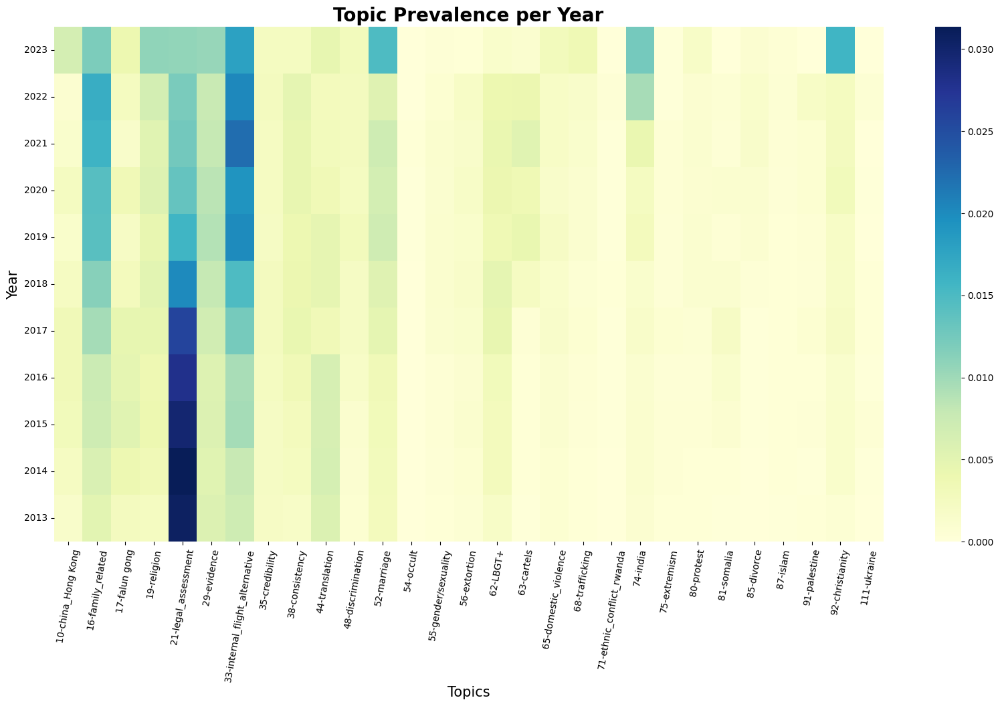

In [57]:
# Plot the heatmap
plt.figure(figsize=(20, 10))

sns.heatmap(df_grouped, annot=False, cmap="YlGnBu")
plt.title('Topic Prevalence per Year', fontsize=20, fontweight='bold')
plt.xlabel('Topics', fontsize = 15)
plt.ylabel('Year', fontsize = 15)

# Set y-axis limits
plt.yticks(rotation=0)  # Rotate y-axis labels for better readability
plt.ylim(0, len(df_grouped.index))  # Set y-axis limits to start at 2013 and end at 2023

# Rotate x-axis labels
plt.xticks(rotation=80)

plt.show()